# **Feal? - Fake or Real?** Binary Classification Using a Custom Augmented Dataset

### Authors: Shreyas Bachiraju and Sounak Ghosh

### **Objective**:

This project aims to classify real vs. AI-generated (fake) images. Binary Classification Using a Custom Augmented Dataset


### **Dataset**:
CIFAKE Dataset:
https://www.kaggle.com/datasets/birdy654/cifake-real-and-ai-generated-synthetic-images/data


### **Methods**:
Binary classification using a pre-trained **RESNET-18**. 

But what's the catch?

In addition to using the CIFAKE dataset, we will create a **Deep Convolutional Generative Adversarial Network (DCGAN)** to generate synthetic images, accounting for approximately 20-30% of the fake images dataset. This will add more diversity to the training and testing data for fake images.

Once the new dataset is prepared, we will fine-tune the pre-trained RESNET-18 model using this augmented dataset, leveraging transfer learning for improved performance.


### **Citations**:
Krizhevsky, A., & Hinton, G. (2009). Learning multiple layers of features from tiny images.

Bird, J.J. and Lotfi, A., 2024. CIFAKE: Image Classification and Explainable Identification of AI-Generated Synthetic Images. IEEE Access.

Real images are from Krizhevsky & Hinton (2009), fake images are from Bird & Lotfi (2024). The Bird & Lotfi study is available here.

Radford, Alec. "Unsupervised representation learning with deep convolutional generative adversarial networks." arXiv preprint arXiv:1511.06434 (2015)

He, Kaiming, et al. "Deep residual learning for image recognition." Proceedings of the IEEE conference on computer vision and pattern recognition. 2016.

### Download the dataset from kaggle

In [ ]:
!pip install kagglehub

In [32]:
import sys
sys.path.append('')
import kagglehub

In [ ]:
path = kagglehub.dataset_download("birdy654/cifake-real-and-ai-generated-synthetic-images")

print("Path to dataset files:", path)

#### Import required libraries

In [22]:
import torch
import torchvision
import torch.nn as nn
import numpy as np
import pandas as pd
from torch.utils.data import random_split, Dataset, DataLoader
from torchvision import datasets, transforms, models
import torchvision.transforms.v2 as transforms
from tqdm import tqdm
import matplotlib.pyplot as plt
import os 
from PIL import Image
from torchvision.utils import make_grid
from matplotlib import animation
from IPython.display import HTML
from torchvision.models import inception_v3
from torchvision.transforms import Resize, Normalize, Compose
import random
from torchvision.utils import save_image
from torchvision.transforms import ToTensor
import torch.optim as optim

### Custom Image Dataset

In [74]:
class ImageDataset(Dataset):
    def __init__(self, root_dir, mode='train', transform=None):
        self.root_dir = os.path.join(root_dir, mode)
        self.transform = transform
        self.classes = {'FAKE': 0, 'REAL': 1}
        self.image_paths = []
        self.labels = []

        # Loop through FAKE and REAL directories
        for class_name, label in self.classes.items():
            class_dir = os.path.join(self.root_dir, class_name)
            for img_name in os.listdir(class_dir):
                img_path = os.path.join(class_dir, img_name)
                if os.path.isfile(img_path):
                    self.image_paths.append(img_path)
                    self.labels.append(label)
                
    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # Load image
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert("RGB")  # Ensure 3 channels

        # Get label
        label = self.labels[idx]

        # Apply transformations
        if self.transform:
            image = self.transform(image)

        return image, label

### Generator and Discriminator Networks for DCGAN

In [5]:
class Generator(nn.Module):
    def __init__(self, latent_dim, img_channels):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            # Input: (latent_dim) x 1 x 1
            nn.ConvTranspose2d(latent_dim, 1024, 4, 1, 0, bias=False), # -> (1024 x 4 x 4)
            nn.BatchNorm2d(1024),
            nn.ReLU(True),

            nn.ConvTranspose2d(1024, 512, 4, 2, 1, bias=False),        # -> (512 x 8 x 8)
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),         # -> (256 x 16 x 16)
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),         # -> (128 x 32 x 32)
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, img_channels, 4, 2, 1, bias=False),# -> (img_channels x 64 x 64)
            nn.Tanh()
        )

    def forward(self, input):
        return self.model(input)


In [6]:
class Discriminator(nn.Module):
    def __init__(self, img_channels):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(img_channels, 128, kernel_size=4, stride=2, padding=1, bias=False),  # 64 -> 32
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),  # 32 -> 16
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),  # 16 -> 8
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(512, 1024, kernel_size=4, stride=2, padding=1, bias=False),  # 8 -> 4
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2, inplace=True),

            # Adjust last layer for 4x4 input
            nn.Conv2d(1024, 1, kernel_size=4, stride=1, padding=0, bias=False),  # 4 -> 1
            nn.Sigmoid()
        )

    def forward(self, img):
        x = self.model(img)
        return x.view(-1)  # Flatten to (batch_size,)

In [ ]:
latent_dim = 100
img_channels = 3 # RGB
beta1 = 0.5  # Adam optimizer beta1

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# initializing generator and discriminator
generator = Generator(latent_dim, img_channels).to(device)
discriminator = Discriminator(img_channels).to(device)

# Initialize weights
def weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.normal_(m.weight, mean=0.0, std=0.02)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.normal_(m.weight, mean=1.0, std=0.02)
        nn.init.constant_(m.bias, 0)

generator.apply(weights_init)
discriminator.apply(weights_init)

# Optimizers
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=0.00005, betas=(0.5, 0.999))
optimizer_G = torch.optim.Adam(generator.parameters(), lr=0.0005, betas=(0.5, 0.999))

#scheduler_D = torch.optim.lr_scheduler.StepLR(optimizer_D, step_size=10, gamma=0.5)
#scheduler_G = torch.optim.lr_scheduler.StepLR(optimizer_G, step_size=10, gamma=0.5)

criterion = nn.BCELoss()

root_dir = "/data/3" # change if required

train_dir = f"{root_dir}/train"

# Transform for DCGAN
dcgan_transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])  # Normalize to [-1, 1]
])

# Load the train dataset
dcgan_train_dataset = datasets.ImageFolder(root=train_dir, transform=dcgan_transform)

In [24]:
class FilteredDataset(Dataset):
    def __init__(self, dataset, target_label):
        self.dataset = dataset
        self.indices = [i for i, (_, label) in enumerate(dataset.samples) if label == target_label]

    def __len__(self):
        return len(self.indices)

    def __getitem__(self, idx):
        actual_idx = self.indices[idx]
        return self.dataset[actual_idx]

fake_train_dataset = FilteredDataset(dcgan_train_dataset, target_label=0)
real_train_dataset = FilteredDataset(dcgan_train_dataset, target_label=1)

# DataLoader for FAKE images
dcgan_fake_dataloader = DataLoader(fake_train_dataset, batch_size=64, shuffle=True)

# DataLoader for Real images
dcgan_real_dataloader = DataLoader(real_train_dataset, batch_size=64, shuffle=True)

# verify DataLoaders
for images, labels in dcgan_fake_dataloader:
    print(f"For fake images dataloader:", images.shape, labels)  # Should show only FAKE images and labels (0)
    break

for images, labels in dcgan_real_dataloader:
    print(f"For real images dataloader:", images.shape, labels)  # Should show only FAKE images and labels (1)
    break

For fake images dataloader: torch.Size([64, 3, 64, 64]) tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])
For real images dataloader: torch.Size([64, 3, 64, 64]) tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])


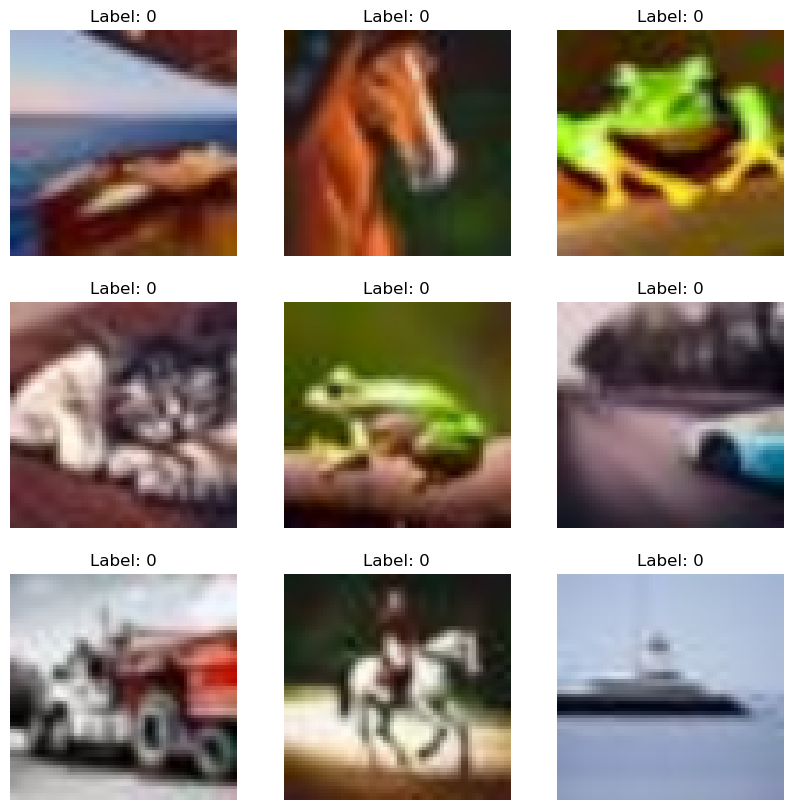

In [25]:
# Denormalize function to bring image values back to [0, 1]
def denormalize(img):
    return img * 0.5 + 0.5  # Reverse normalization from [-1, 1] to [0, 1]

# plot some fake images
images, labels = next(iter(dcgan_fake_dataloader))
plt.figure(figsize=(10, 10))
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.imshow(denormalize(images[i]).permute(1, 2, 0).numpy())
    plt.title(f"Label: {labels[i].item()}")
    plt.axis("off")
plt.show()

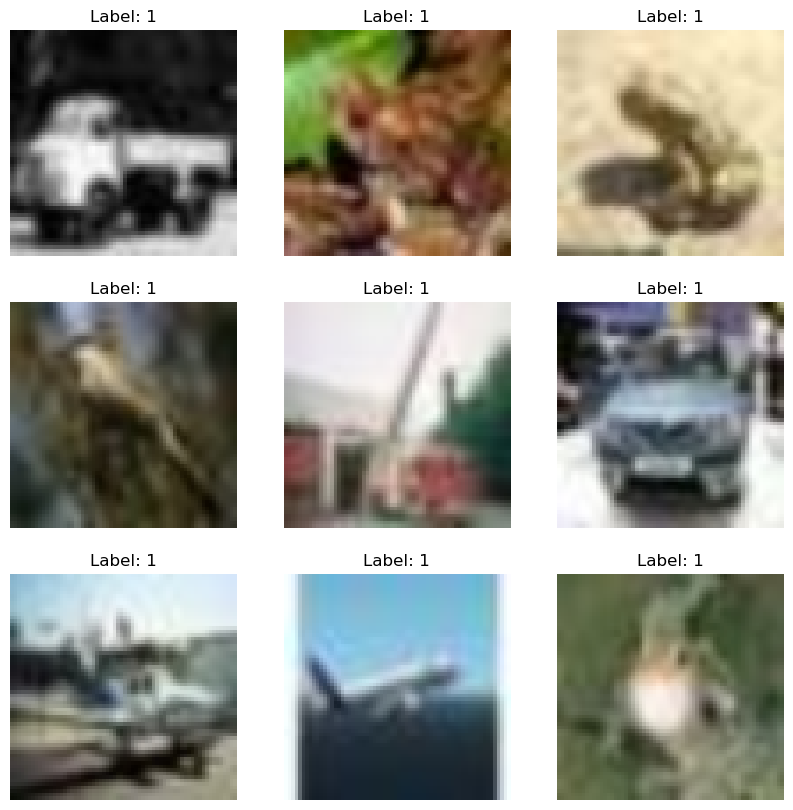

In [26]:
# Plot some real images
images, labels = next(iter(dcgan_real_dataloader))
plt.figure(figsize=(10, 10))
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.imshow(denormalize(images[i]).permute(1, 2, 0).numpy())
    plt.title(f"Label: {labels[i].item()}")
    plt.axis("off")
plt.show()

In [27]:
print(torch.cuda.is_available())

True


In [157]:
# noise generation function
def generate_noise(batch_size, latent_dim, device):
    return torch.randn(batch_size, latent_dim, 1, 1, device=device)

fixed_noise = generate_noise(64, latent_dim, device)  # 64 fixed noise samples
img_list = [] 

num_epochs = 50 


# Training loop #
for epoch in range(num_epochs):
    epoch_d_loss = 0
    epoch_g_loss = 0
    num_batches = 0

    with tqdm(dcgan_real_dataloader, desc=f"Epoch {epoch+1}/{num_epochs}", unit="batch") as pbar:
        for real_images, _ in pbar:
            batch_size = real_images.size(0)
            real_images = real_images.to(device)

            # Label smoothing for real labels
            real_labels = torch.full((batch_size,), 0.9, device=device)  # Smooth real labels
            fake_labels = torch.zeros(batch_size, device=device)         # Fake labels remain 0

            # Add noise to real images
            real_images = real_images + 0.05 * torch.randn_like(real_images).to(device)

            # ---------------------
            # Train Discriminator
            #######################
            optimizer_D.zero_grad()

            # Discriminator on real images
            real_outputs = discriminator(real_images)
            d_loss_real = criterion(real_outputs, real_labels)

            # Generate fake images
            noise = generate_noise(batch_size, latent_dim, device)
            fake_images = generator(noise)

            # Add noise to fake images
            fake_images = fake_images + 0.05 * torch.randn_like(fake_images).to(device)

            # Discriminator on fake images
            fake_outputs = discriminator(fake_images.detach())  # Detach to avoid backprop in Generator
            d_loss_fake = criterion(fake_outputs, fake_labels)

            # Total Discriminator loss
            d_loss = d_loss_real + d_loss_fake
            d_loss.backward()

            # Clip gradients for stability
            torch.nn.utils.clip_grad_norm_(discriminator.parameters(), max_norm=1.0)
            optimizer_D.step()

            # -----------------
            # Train Generator
            ###################
            optimizer_G.zero_grad()

            # generate fake images and train generator
            fake_outputs = discriminator(fake_images)
            g_loss = criterion(fake_outputs, real_labels)  # use real_labels to trick the discriminator
            g_loss.backward()

            # clip gradients
            torch.nn.utils.clip_grad_norm_(generator.parameters(), max_norm=1.0)
            optimizer_G.step()

            # accumulate losses for averaging
            epoch_d_loss += d_loss.item()
            epoch_g_loss += g_loss.item()
            num_batches += 1
            
        #scheduler_D.step()
        #scheduler_G.step()
        
        # average epoch losses
        avg_d_loss = epoch_d_loss / num_batches
        avg_g_loss = epoch_g_loss / num_batches

        print(f"Epoch {epoch+1}/{num_epochs} - Avg D Loss: {avg_d_loss:.4f}, Avg G Loss: {avg_g_loss:.4f}")

        # generate and save images using fixed_noise
        with torch.no_grad():
            fake_images = generator(fixed_noise).cpu()
            img_list.append(make_grid(denormalize(fake_images), nrow=8).numpy())  # Save grid of images

Epoch 1/50: 100%|██████████| 782/782 [00:36<00:00, 21.47batch/s]


Epoch 1/50 - Avg D Loss: 3.3328, Avg G Loss: 2.2180


Epoch 2/50: 100%|██████████| 782/782 [00:37<00:00, 21.07batch/s]


Epoch 2/50 - Avg D Loss: 1.4434, Avg G Loss: 0.9341


Epoch 3/50: 100%|██████████| 782/782 [00:36<00:00, 21.45batch/s]


Epoch 3/50 - Avg D Loss: 1.4208, Avg G Loss: 0.8891


Epoch 4/50: 100%|██████████| 782/782 [00:36<00:00, 21.46batch/s]


Epoch 4/50 - Avg D Loss: 1.4014, Avg G Loss: 0.9087


Epoch 5/50: 100%|██████████| 782/782 [00:36<00:00, 21.37batch/s]


Epoch 5/50 - Avg D Loss: 1.3943, Avg G Loss: 0.8998


Epoch 6/50: 100%|██████████| 782/782 [00:37<00:00, 21.09batch/s]


Epoch 6/50 - Avg D Loss: 1.3834, Avg G Loss: 0.8981


Epoch 7/50: 100%|██████████| 782/782 [00:36<00:00, 21.51batch/s]


Epoch 7/50 - Avg D Loss: 1.3807, Avg G Loss: 0.8973


Epoch 8/50: 100%|██████████| 782/782 [00:36<00:00, 21.66batch/s]


Epoch 8/50 - Avg D Loss: 1.3902, Avg G Loss: 0.8817


Epoch 9/50: 100%|██████████| 782/782 [00:36<00:00, 21.43batch/s]


Epoch 9/50 - Avg D Loss: 1.3901, Avg G Loss: 0.8677


Epoch 10/50: 100%|██████████| 782/782 [00:36<00:00, 21.19batch/s]


Epoch 10/50 - Avg D Loss: 1.3903, Avg G Loss: 0.8640


Epoch 11/50: 100%|██████████| 782/782 [00:36<00:00, 21.39batch/s]


Epoch 11/50 - Avg D Loss: 1.3874, Avg G Loss: 0.8573


Epoch 12/50: 100%|██████████| 782/782 [00:36<00:00, 21.54batch/s]


Epoch 12/50 - Avg D Loss: 1.3876, Avg G Loss: 0.8593


Epoch 13/50: 100%|██████████| 782/782 [00:36<00:00, 21.34batch/s]


Epoch 13/50 - Avg D Loss: 1.3826, Avg G Loss: 0.8606


Epoch 14/50: 100%|██████████| 782/782 [00:35<00:00, 21.72batch/s]


Epoch 14/50 - Avg D Loss: 1.3819, Avg G Loss: 0.8658


Epoch 15/50: 100%|██████████| 782/782 [00:36<00:00, 21.34batch/s]


Epoch 15/50 - Avg D Loss: 1.3803, Avg G Loss: 0.8643


Epoch 16/50: 100%|██████████| 782/782 [00:36<00:00, 21.54batch/s]


Epoch 16/50 - Avg D Loss: 1.3777, Avg G Loss: 0.8668


Epoch 17/50: 100%|██████████| 782/782 [00:35<00:00, 21.81batch/s]


Epoch 17/50 - Avg D Loss: 1.3778, Avg G Loss: 0.8684


Epoch 18/50: 100%|██████████| 782/782 [00:36<00:00, 21.39batch/s]


Epoch 18/50 - Avg D Loss: 1.3796, Avg G Loss: 0.8670


Epoch 19/50: 100%|██████████| 782/782 [00:36<00:00, 21.55batch/s]


Epoch 19/50 - Avg D Loss: 1.3761, Avg G Loss: 0.8671


Epoch 20/50: 100%|██████████| 782/782 [00:36<00:00, 21.27batch/s]


Epoch 20/50 - Avg D Loss: 1.3784, Avg G Loss: 0.8686


Epoch 21/50: 100%|██████████| 782/782 [00:35<00:00, 22.12batch/s]


Epoch 21/50 - Avg D Loss: 1.3770, Avg G Loss: 0.8646


Epoch 22/50: 100%|██████████| 782/782 [00:35<00:00, 22.34batch/s]


Epoch 22/50 - Avg D Loss: 1.3762, Avg G Loss: 0.8687


Epoch 23/50: 100%|██████████| 782/782 [00:36<00:00, 21.15batch/s]


Epoch 23/50 - Avg D Loss: 1.3762, Avg G Loss: 0.8695


Epoch 24/50: 100%|██████████| 782/782 [00:35<00:00, 21.73batch/s]


Epoch 24/50 - Avg D Loss: 1.3704, Avg G Loss: 0.8747


Epoch 25/50: 100%|██████████| 782/782 [00:36<00:00, 21.64batch/s]


Epoch 25/50 - Avg D Loss: 1.3690, Avg G Loss: 0.8815


Epoch 26/50: 100%|██████████| 782/782 [00:35<00:00, 22.09batch/s]


Epoch 26/50 - Avg D Loss: 1.3610, Avg G Loss: 0.8920


Epoch 27/50: 100%|██████████| 782/782 [00:35<00:00, 21.98batch/s]


Epoch 27/50 - Avg D Loss: 1.3606, Avg G Loss: 0.8911


Epoch 28/50: 100%|██████████| 782/782 [00:34<00:00, 22.36batch/s]


Epoch 28/50 - Avg D Loss: 1.3537, Avg G Loss: 0.9030


Epoch 29/50: 100%|██████████| 782/782 [00:35<00:00, 22.33batch/s]


Epoch 29/50 - Avg D Loss: 1.3530, Avg G Loss: 0.9127


Epoch 30/50: 100%|██████████| 782/782 [00:35<00:00, 21.99batch/s]


Epoch 30/50 - Avg D Loss: 1.3513, Avg G Loss: 0.9125


Epoch 31/50: 100%|██████████| 782/782 [00:35<00:00, 22.22batch/s]


Epoch 31/50 - Avg D Loss: 1.3425, Avg G Loss: 0.9260


Epoch 32/50: 100%|██████████| 782/782 [00:35<00:00, 21.90batch/s]


Epoch 32/50 - Avg D Loss: 1.3359, Avg G Loss: 0.9389


Epoch 33/50: 100%|██████████| 782/782 [00:35<00:00, 22.33batch/s]


Epoch 33/50 - Avg D Loss: 1.3305, Avg G Loss: 0.9521


Epoch 34/50: 100%|██████████| 782/782 [00:35<00:00, 21.77batch/s]


Epoch 34/50 - Avg D Loss: 1.3218, Avg G Loss: 0.9677


Epoch 35/50: 100%|██████████| 782/782 [00:35<00:00, 21.88batch/s]


Epoch 35/50 - Avg D Loss: 1.3131, Avg G Loss: 0.9843


Epoch 36/50: 100%|██████████| 782/782 [00:36<00:00, 21.49batch/s]


Epoch 36/50 - Avg D Loss: 1.3101, Avg G Loss: 0.9942


Epoch 37/50: 100%|██████████| 782/782 [00:36<00:00, 21.31batch/s]


Epoch 37/50 - Avg D Loss: 1.2999, Avg G Loss: 1.0073


Epoch 38/50: 100%|██████████| 782/782 [00:37<00:00, 20.72batch/s]


Epoch 38/50 - Avg D Loss: 1.2859, Avg G Loss: 1.0325


Epoch 39/50: 100%|██████████| 782/782 [00:41<00:00, 19.03batch/s]


Epoch 39/50 - Avg D Loss: 1.2805, Avg G Loss: 1.0439


Epoch 40/50: 100%|██████████| 782/782 [00:42<00:00, 18.55batch/s]


Epoch 40/50 - Avg D Loss: 1.2737, Avg G Loss: 1.0715


Epoch 41/50: 100%|██████████| 782/782 [00:37<00:00, 20.92batch/s]


Epoch 41/50 - Avg D Loss: 1.2589, Avg G Loss: 1.0821


Epoch 42/50: 100%|██████████| 782/782 [00:34<00:00, 22.41batch/s]


Epoch 42/50 - Avg D Loss: 1.2479, Avg G Loss: 1.1094


Epoch 43/50: 100%|██████████| 782/782 [00:35<00:00, 22.31batch/s]


Epoch 43/50 - Avg D Loss: 1.2349, Avg G Loss: 1.1345


Epoch 44/50: 100%|██████████| 782/782 [00:37<00:00, 21.00batch/s]


Epoch 44/50 - Avg D Loss: 1.2246, Avg G Loss: 1.1545


Epoch 45/50: 100%|██████████| 782/782 [00:36<00:00, 21.21batch/s]


Epoch 45/50 - Avg D Loss: 1.2270, Avg G Loss: 1.1759


Epoch 46/50: 100%|██████████| 782/782 [00:35<00:00, 21.79batch/s]


Epoch 46/50 - Avg D Loss: 1.2118, Avg G Loss: 1.1895


Epoch 47/50: 100%|██████████| 782/782 [00:36<00:00, 21.40batch/s]


Epoch 47/50 - Avg D Loss: 1.2022, Avg G Loss: 1.2096


Epoch 48/50: 100%|██████████| 782/782 [00:36<00:00, 21.57batch/s]


Epoch 48/50 - Avg D Loss: 1.1916, Avg G Loss: 1.2486


Epoch 49/50: 100%|██████████| 782/782 [00:35<00:00, 21.74batch/s]


Epoch 49/50 - Avg D Loss: 1.1912, Avg G Loss: 1.2589


Epoch 50/50: 100%|██████████| 782/782 [00:36<00:00, 21.38batch/s]

Epoch 50/50 - Avg D Loss: 1.1857, Avg G Loss: 1.2771


In [159]:
### Train further for additional 20 epochs ###
additional_epochs = 20
total_epochs = 50 + additional_epochs

# Continue training for additional epochs
for epoch in range(50, total_epochs):  # Start from epoch 50
    epoch_d_loss = 0
    epoch_g_loss = 0
    num_batches = 0

    with tqdm(dcgan_real_dataloader, desc=f"Epoch {epoch+1}/{total_epochs}", unit="batch") as pbar:
        for real_images, _ in pbar:
            batch_size = real_images.size(0)
            real_images = real_images.to(device)

            # Label smoothing for real labels
            real_labels = torch.full((batch_size,), 0.9, device=device)  # Smooth real labels
            fake_labels = torch.zeros(batch_size, device=device)         # Fake labels remain 0

            # add noise to real images
            real_images = real_images + 0.05 * torch.randn_like(real_images).to(device)

            # ---------------------
            # Train Discriminator
            # ---------------------
            optimizer_D.zero_grad()

            # discriminator on real images
            real_outputs = discriminator(real_images)
            d_loss_real = criterion(real_outputs, real_labels)

            # generate fake images
            noise = generate_noise(batch_size, latent_dim, device)
            fake_images = generator(noise)

            # add noise to fake images
            fake_images = fake_images + 0.05 * torch.randn_like(fake_images).to(device)

            # discriminator on fake images
            fake_outputs = discriminator(fake_images.detach())
            d_loss_fake = criterion(fake_outputs, fake_labels)

            # Total discriminator loss
            d_loss = d_loss_real + d_loss_fake
            d_loss.backward()

            # dlip gradients
            torch.nn.utils.clip_grad_norm_(discriminator.parameters(), max_norm=1.0)
            optimizer_D.step()

            # -----------------
            # Train Generator
            # -----------------
            optimizer_G.zero_grad()

            # Generate fake images and train Generator
            fake_outputs = discriminator(fake_images)
            g_loss = criterion(fake_outputs, real_labels)  # Use real_labels to trick the Discriminator
            g_loss.backward()

            # Clip gradients for stability
            torch.nn.utils.clip_grad_norm_(generator.parameters(), max_norm=1.0)
            optimizer_G.step()

            # Accumulate losses for averaging
            epoch_d_loss += d_loss.item()
            epoch_g_loss += g_loss.item()
            num_batches += 1

        # Compute average epoch losses
        avg_d_loss = epoch_d_loss / num_batches
        avg_g_loss = epoch_g_loss / num_batches

        print(f"Epoch {epoch+1}/{total_epochs} - Avg D Loss: {avg_d_loss:.4f}, Avg G Loss: {avg_g_loss:.4f}")

        # save generated images for evaluation
        with torch.no_grad():
            fake_images = generator(fixed_noise).cpu()
            img_list.append(make_grid(denormalize(fake_images), nrow=8).numpy())

Epoch 51/70: 100%|██████████| 782/782 [00:35<00:00, 21.84batch/s]


Epoch 51/70 - Avg D Loss: 1.1548, Avg G Loss: 1.3053


Epoch 52/70: 100%|██████████| 782/782 [00:36<00:00, 21.30batch/s]


Epoch 52/70 - Avg D Loss: 1.1554, Avg G Loss: 1.3194


Epoch 53/70: 100%|██████████| 782/782 [00:35<00:00, 22.04batch/s]


Epoch 53/70 - Avg D Loss: 1.1583, Avg G Loss: 1.3477


Epoch 54/70: 100%|██████████| 782/782 [00:35<00:00, 22.10batch/s]


Epoch 54/70 - Avg D Loss: 1.1385, Avg G Loss: 1.3662


Epoch 55/70: 100%|██████████| 782/782 [00:35<00:00, 21.97batch/s]


Epoch 55/70 - Avg D Loss: 1.1354, Avg G Loss: 1.3810


Epoch 56/70: 100%|██████████| 782/782 [00:36<00:00, 21.58batch/s]


Epoch 56/70 - Avg D Loss: 1.1387, Avg G Loss: 1.4296


Epoch 57/70: 100%|██████████| 782/782 [00:36<00:00, 21.69batch/s]


Epoch 57/70 - Avg D Loss: 1.1177, Avg G Loss: 1.4456


Epoch 58/70: 100%|██████████| 782/782 [00:36<00:00, 21.57batch/s]


Epoch 58/70 - Avg D Loss: 1.1091, Avg G Loss: 1.4563


Epoch 59/70: 100%|██████████| 782/782 [00:36<00:00, 21.48batch/s]


Epoch 59/70 - Avg D Loss: 1.0991, Avg G Loss: 1.4814


Epoch 60/70: 100%|██████████| 782/782 [00:36<00:00, 21.30batch/s]


Epoch 60/70 - Avg D Loss: 1.0892, Avg G Loss: 1.5014


Epoch 61/70: 100%|██████████| 782/782 [00:35<00:00, 21.88batch/s]


Epoch 61/70 - Avg D Loss: 1.0800, Avg G Loss: 1.5410


Epoch 62/70: 100%|██████████| 782/782 [00:35<00:00, 21.99batch/s]


Epoch 62/70 - Avg D Loss: 1.0660, Avg G Loss: 1.5558


Epoch 63/70: 100%|██████████| 782/782 [00:35<00:00, 21.91batch/s]


Epoch 63/70 - Avg D Loss: 1.0500, Avg G Loss: 1.5921


Epoch 64/70: 100%|██████████| 782/782 [00:35<00:00, 21.90batch/s]


Epoch 64/70 - Avg D Loss: 1.0517, Avg G Loss: 1.6286


Epoch 65/70: 100%|██████████| 782/782 [00:35<00:00, 22.03batch/s]


Epoch 65/70 - Avg D Loss: 1.0399, Avg G Loss: 1.6333


Epoch 66/70: 100%|██████████| 782/782 [00:36<00:00, 21.65batch/s]


Epoch 66/70 - Avg D Loss: 1.0323, Avg G Loss: 1.6687


Epoch 67/70: 100%|██████████| 782/782 [00:35<00:00, 21.73batch/s]


Epoch 67/70 - Avg D Loss: 1.0179, Avg G Loss: 1.7017


Epoch 68/70: 100%|██████████| 782/782 [00:36<00:00, 21.52batch/s]


Epoch 68/70 - Avg D Loss: 1.0161, Avg G Loss: 1.7187


Epoch 69/70: 100%|██████████| 782/782 [00:36<00:00, 21.50batch/s]


Epoch 69/70 - Avg D Loss: 0.9961, Avg G Loss: 1.7452


Epoch 70/70: 100%|██████████| 782/782 [00:35<00:00, 21.74batch/s]

Epoch 70/70 - Avg D Loss: 1.0011, Avg G Loss: 1.7721


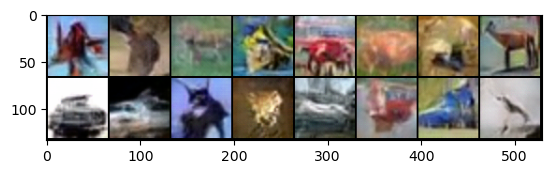

In [160]:
with torch.no_grad():
    noise = generate_noise(batch_size, latent_dim, device)
    fake_images = generator(noise).cpu()
    grid = torchvision.utils.make_grid(denormalize(fake_images), nrow=8)
    plt.imshow(grid.permute(1, 2, 0))
    plt.show()

Animation size has reached 21779011 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


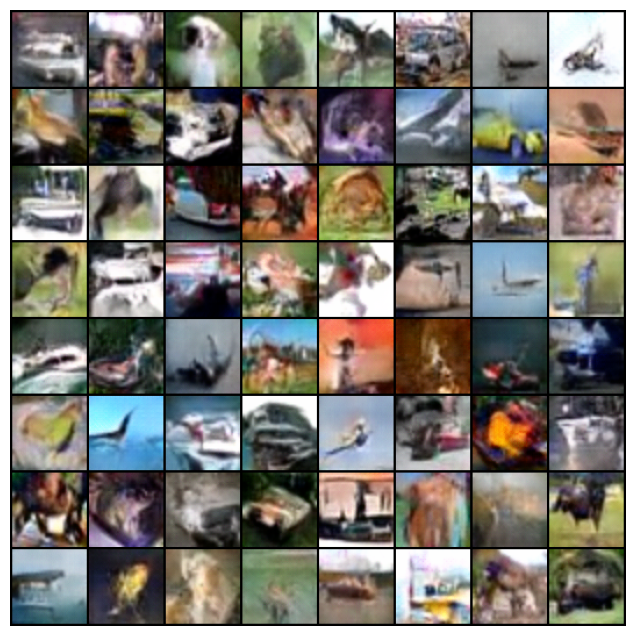

In [161]:
# Cool animation to visualize the generator's progression as an animation!
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(img, (1, 2, 0)), animated=True)] for img in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

In [162]:
# Save the trained Generator and Discriminator
torch.save(generator.state_dict(), "generator_70epochs.pth")
torch.save(discriminator.state_dict(), "discriminator_70epochs.pth")
print("Models saved successfully!")

Models saved successfully!


#### Metrics - Inception Score

The Inception Score (IS) evaluates the quality and diversity of generated images by measuring how confidently they are classified into distinct classes using a pre-trained model, with higher scores indicating better diversity and realism.


In [ ]:
def calculate_inception_score(images, num_splits=10, device='cuda'):
    # Load pretrained InceptionV3 model
    inception = inception_v3(pretrained=True, transform_input=False).eval().to(device)
    inception.fc = torch.nn.Identity()  # Remove the classification layer

    # Resize and normalize the images
    transform = Compose([
        Resize((299, 299)),  # Resize to 299x299
        Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
    ])
    images = transform(images.to(device))

    # Extract predictions from the Inception model
    with torch.no_grad():
        preds = inception(images).softmax(dim=1).cpu().numpy()

    # Split the predictions into subsets and calculate the score
    scores = []
    for i in range(num_splits):
        part = preds[i * (len(preds) // num_splits):(i + 1) * (len(preds) // num_splits)]
        p_y = np.mean(part, axis=0)
        scores.append(np.exp(np.mean(np.sum(part * np.log(part / p_y), axis=1))))

    return np.mean(scores), np.std(scores)

fake_images_batch = fake_images_batch.to('cuda')  # Move to GPU

# Calculate Inception Score
is_mean, is_std = calculate_inception_score(fake_images_batch, device='cuda')
print(f"Inception Score: {is_mean} ± {is_std}")


In [164]:
real_images_batch, _ = next(iter(dcgan_real_dataloader))
real_images_batch = real_images_batch.to('cuda')

is_mean_real, is_std_real = calculate_inception_score(real_images_batch, device='cuda')
print(f"Real Dataset Inception Score: {is_mean_real} ± {is_std_real}")

Real Dataset Inception Score: 1.0808078050613403 ± 0.021386807784438133


#### Inference

The Generator's Inception Score (1.046 ± 0.017) closely matches the Real Dataset's Inception Score (1.081 ± 0.022), indicating the Generator is effectively replicating the dataset's characteristics, although with limited diversity and quality due to dataset constraints.

In [33]:
# Loading trained generator and discrimintor
generator_state_dict = torch.load('generator_70epochs.pth', weights_only=True)
discriminator_state_dict = torch.load('discriminator_70epochs.pth', weights_only=True)
generator.load_state_dict(generator_state_dict)
discriminator.load_state_dict(discriminator_state_dict)
generator.to(device)
discriminator.to(device)
generator.eval()
discriminator.eval()

Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(1024, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [34]:
# Print number of parameters for each layer
print("Generator parameters:")
for name, param in generator.named_parameters():
    print(f"{name}: {param.size()}")

print("\nDiscriminator parameters:")
for name, param in discriminator.named_parameters():
    print(f"{name}: {param.size()}")

Generator parameters:
model.0.weight: torch.Size([100, 1024, 4, 4])
model.1.weight: torch.Size([1024])
model.1.bias: torch.Size([1024])
model.3.weight: torch.Size([1024, 512, 4, 4])
model.4.weight: torch.Size([512])
model.4.bias: torch.Size([512])
model.6.weight: torch.Size([512, 256, 4, 4])
model.7.weight: torch.Size([256])
model.7.bias: torch.Size([256])
model.9.weight: torch.Size([256, 128, 4, 4])
model.10.weight: torch.Size([128])
model.10.bias: torch.Size([128])
model.12.weight: torch.Size([128, 3, 4, 4])

Discriminator parameters:
model.0.weight: torch.Size([128, 3, 4, 4])
model.2.weight: torch.Size([256, 128, 4, 4])
model.3.weight: torch.Size([256])
model.3.bias: torch.Size([256])
model.5.weight: torch.Size([512, 256, 4, 4])
model.6.weight: torch.Size([512])
model.6.bias: torch.Size([512])
model.8.weight: torch.Size([1024, 512, 4, 4])
model.9.weight: torch.Size([1024])
model.9.bias: torch.Size([1024])
model.11.weight: torch.Size([1, 1024, 4, 4])


## Modifying original CIFAKE dataset using DCGAN



In [35]:
# Base directories
base_dir = "/data/"
augmented_dir = os.path.join(base_dir, "augmented/")

original_dir = os.path.join(base_dir, "3")
train_dir = os.path.join(original_dir, "train")
test_dir = os.path.join(original_dir, "test")

# augmented dataset paths
augmented_train_dir = os.path.join(augmented_dir, "train")
augmented_test_dir = os.path.join(augmented_dir, "test")

# subdirectories for FAKE and REAL in augmented dataset
augmented_train_fake_dir = os.path.join(augmented_train_dir, "FAKE")
augmented_train_real_dir = os.path.join(augmented_train_dir, "REAL")
augmented_test_fake_dir = os.path.join(augmented_test_dir, "FAKE")
augmented_test_real_dir = os.path.join(augmented_test_dir, "REAL")

os.makedirs(augmented_train_fake_dir, exist_ok=True)
os.makedirs(augmented_train_real_dir, exist_ok=True)
os.makedirs(augmented_test_fake_dir, exist_ok=True)
os.makedirs(augmented_test_real_dir, exist_ok=True)

print(f"Augmented dataset will be saved to {augmented_dir}")

Augmented dataset will be saved to /home/sbachira/cifake-project/data/augmented/


In [54]:
# function to check balance in train and test datasets

def check_balance(directory):
    splits = ["train", "test"]
    classes = ["REAL", "FAKE"]

    overall_counts = {"train": 0, "test": 0}

    try:
        for split in splits:
            print(f"Checking {split.upper()} split:")
            total_images = 0
            for cls in classes:
                class_dir = os.path.join(directory, split, cls)
                if not os.path.exists(class_dir):
                    print(f"  Warning: {class_dir} does not exist!")
                    continue
                num_images = len([f for f in os.listdir(class_dir) if f.endswith(('.png', '.jpg', '.jpeg'))])
                total_images += num_images
                print(f"  {cls}: {num_images} images")
            overall_counts[split] = total_images
            print(f"  Total images in {split}: {total_images}\n")

        # Summary
        print("Summary:")
        for split, count in overall_counts.items():
            print(f"  {split.upper()} split: {count} total images")
    except Exception as e:
        print(f"Error: {e}")

In [55]:
cifake_dir = "data/3/"
check_balance(cifake_dir)

Checking TRAIN split:
  REAL: 50000 images
  FAKE: 50000 images
  Total images in train: 100000

Checking TEST split:
  REAL: 10000 images
  FAKE: 10000 images
  Total images in test: 20000

Summary:
  TRAIN split: 100000 total images
  TEST split: 20000 total images


In [47]:
def get_image_paths(directory):
    return [
        os.path.join(directory, img)
        for img in os.listdir(directory)
        if os.path.isfile(os.path.join(directory, img))
    ]

def split_and_save_images(image_paths, target_train, target_test, train_dir, test_dir, prefix):
    """Split image paths into train/test and save them."""
    random.seed(42)
    random.shuffle(image_paths)
    
    train_images = image_paths[:target_train]
    test_images = image_paths[target_train:target_train + target_test]
    
    # Save train images
    for i, src_path in enumerate(train_images):
        dst_path = os.path.join(train_dir, f"{prefix}_train_{i}.png")
        img = Image.open(src_path)
        img.save(dst_path)
    
    # Save test images
    for i, src_path in enumerate(test_images):
        dst_path = os.path.join(test_dir, f"{prefix}_test_{i}.png")
        img = Image.open(src_path)
        img.save(dst_path)
    
    return len(train_images), len(test_images)

In [48]:
# Load CIFAKE FAKE image paths
cifake_train_fake_dir = os.path.join(train_dir, "FAKE")
cifake_test_fake_dir = os.path.join(test_dir, "FAKE")
cifake_fake_images = get_image_paths(cifake_train_fake_dir) + get_image_paths(cifake_test_fake_dir)

# Define the split sizes
target_train_cifake_fake = 40_000
target_test_cifake_fake = 8_000

# Split and save CIFAKE FAKE images
print("Processing CIFAKE FAKE images...")
train_count, test_count = split_and_save_images(
    cifake_fake_images,
    target_train_cifake_fake,
    target_test_cifake_fake,
    augmented_train_fake_dir,
    augmented_test_fake_dir,
    prefix="cifake_fake"
)

print(f"CIFAKE FAKE images processed: {train_count} train, {test_count} test")

Processing CIFAKE FAKE images...
CIFAKE FAKE images processed: 40000 train, 8000 test


In [49]:
# Load CIFAKE REAL image paths
cifake_real_train_dir = os.path.join(train_dir, "REAL")
cifake_real_test_dir = os.path.join(test_dir, "REAL")
cifake_real_images = get_image_paths(cifake_real_train_dir) + get_image_paths(cifake_real_test_dir)

# Define the split sizes
target_train_cifake_real = 50_000
target_test_cifake_real = 10_000

# Split and save CIFAKE REAL images
print("Processing CIFAKE REAL images...")
train_real_count, test_real_count = split_and_save_images(
    cifake_real_images,
    target_train_cifake_real,
    target_test_cifake_real,
    augmented_train_real_dir,
    augmented_test_real_dir,
    prefix="cifake_real"
)

print(f"CIFAKE REAL images processed: {train_real_count} train, {test_real_count} test")

Processing CIFAKE REAL images...
CIFAKE REAL images processed: 50000 train, 10000 test


In [50]:
total_dcgan_fake_images = 12_000  # Total DCGAN fake images
train_dcgan_fake = 10_000  # DCGAN fake images for training
test_dcgan_fake = 2_000  # DCGAN fake images for testing
batch_size = 64

print("Generating DCGAN fake images...")
generator.eval()

# function to generate and save images
def generate_and_save_dcgan_images(num_images, save_dir, prefix):
    with torch.no_grad():
        for i in range(0, num_images, batch_size):
            noise = generate_noise(min(batch_size, num_images - i), latent_dim, device)
            fake_images = generator(noise).cpu()
            for j, img in enumerate(fake_images):
                save_image(denormalize(img), os.path.join(save_dir, f"{prefix}_{i+j}.png"))

# generate training DCGAN fake images
print("Saving DCGAN train FAKE images...")
generate_and_save_dcgan_images(train_dcgan_fake, augmented_train_fake_dir, prefix="dcgan_fake_train")

# generate testing DCGAN fake images
print("Saving DCGAN test FAKE images...")
generate_and_save_dcgan_images(test_dcgan_fake, augmented_test_fake_dir, prefix="dcgan_fake_test")

print(f"Generated {total_dcgan_fake_images} DCGAN fake images.")

Generating DCGAN fake images...
Saving DCGAN train FAKE images...
Saving DCGAN test FAKE images...
Generated 12000 DCGAN fake images.


In [56]:
# Path to augmented dataset
augmented_dir = "data/augmented/"

# Check balance
check_balance(augmented_dir)

Checking TRAIN split:
  REAL: 50000 images
  FAKE: 50000 images
  Total images in train: 100000

Checking TEST split:
  REAL: 10000 images
  FAKE: 10000 images
  Total images in test: 20000

Summary:
  TRAIN split: 100000 total images
  TEST split: 20000 total images


#### **Note**: The augmented dataset preserves the original dataset balance

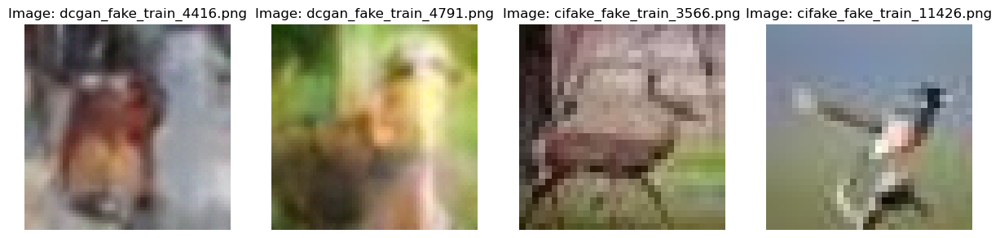

In [72]:
def randomly_open_images(directory, num_images=5):
    # Get the list of image files in the directory
    image_files = [f for f in os.listdir(directory) if f.endswith(('.png', '.jpg', '.jpeg'))]
    
    if not image_files:
        print(f"No image files found in {directory}.")
        return
    
    # Randomly select the specified number of images
    selected_images = random.sample(image_files, min(num_images, len(image_files)))

    # Display the selected images
    plt.figure(figsize=(15, 5))
    for i, img_file in enumerate(selected_images):
        img_path = os.path.join(directory, img_file)
        img = Image.open(img_path)
        plt.subplot(1, num_images, i + 1)
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"Image: {img_file}")
    plt.show()

dcgan_fake_dir = "data/augmented/train/FAKE"
randomly_open_images(dcgan_fake_dir, num_images=4)

### Now that the dataset has been setup, let's go ahead with binary classification

In [75]:
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
}

root_dir = "/data/augmented"
train_dataset = ImageDataset(root_dir=root_dir, mode='train', transform=data_transforms['train'])
test_dataset = ImageDataset(root_dir=root_dir, mode='test', transform=data_transforms['test'])

batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Verify dataset size
print(f"Training set size: {len(train_dataset)} images")
print(f"Testing set size: {len(test_dataset)} images")

Training set size: 100000 images
Testing set size: 20000 images


In [ ]:
from torchvision.models import resnet50

model = models.resnet18(pretrained=True)

#model = resnet50(pretrained=True)
num_classes = 2
model.fc = nn.Linear(model.fc.in_features, num_classes)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

print(model)

In [112]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-4)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

In [113]:
# store the loss and accuracy for each epoch
epoch_losses = []
avg_epoch_losses = []
epoch_accuracies = []

# set number of epochs
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    with tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}", unit="batch") as pbar:
        for images, labels in pbar:
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()

            outputs = model(images)
            loss = criterion(outputs, labels)

            loss.backward()
            optimizer.step()

            # update cumulative loss
            running_loss += loss.item() * images.size(0)

            # get predictions and compute batch accuracy
            _, predicted = torch.max(outputs, 1)
            batch_correct = (predicted == labels).sum().item()
            batch_total = labels.size(0)
            
            # accumulate correct predictions and total images for the epoch
            correct += batch_correct
            total += batch_total

            pbar.set_postfix({
                "Batch Loss": f"{loss.item():.4f}",
                "Batch Accuracy": f"{(batch_correct / batch_total) * 100:.2f}%"
            })

    # calculate average loss and total accuracy for the entire epoch
    avg_loss = running_loss / total
    epoch_acc = correct / total

    # store the loss and accuracy for the epoch
    epoch_losses.append(avg_loss)
    avg_epoch_losses.append(avg_loss)
    epoch_accuracies.append(epoch_acc)

    # print epoch statistics (average loss and accuracy)
    print(f"Epoch {epoch+1}/{num_epochs}, Avg Loss: {avg_loss:.4f}, Accuracy: {epoch_acc * 100:.2f}%")

    scheduler.step()

    model.eval() 
    test_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * images.size(0)

            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

    test_loss /= total
    test_acc = correct / total
    print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_acc * 100:.2f}%")

Epoch 1/10: 100%|██████████| 1563/1563 [03:34<00:00,  7.28batch/s, Batch Loss=0.0788, Batch Accuracy=93.75%] 


Epoch 1/10, Avg Loss: 0.0697, Accuracy: 97.38%
Test Loss: 0.1130, Test Accuracy: 95.86%


Epoch 2/10: 100%|██████████| 1563/1563 [03:38<00:00,  7.17batch/s, Batch Loss=0.0449, Batch Accuracy=96.88%] 


Epoch 2/10, Avg Loss: 0.0665, Accuracy: 97.48%
Test Loss: 0.1127, Test Accuracy: 95.62%


Epoch 3/10: 100%|██████████| 1563/1563 [03:18<00:00,  7.89batch/s, Batch Loss=0.1351, Batch Accuracy=90.62%] 


Epoch 3/10, Avg Loss: 0.0673, Accuracy: 97.42%
Test Loss: 0.1055, Test Accuracy: 95.89%


Epoch 4/10: 100%|██████████| 1563/1563 [03:18<00:00,  7.89batch/s, Batch Loss=0.0025, Batch Accuracy=100.00%]


Epoch 4/10, Avg Loss: 0.0619, Accuracy: 97.62%
Test Loss: 0.0880, Test Accuracy: 96.76%


Epoch 5/10: 100%|██████████| 1563/1563 [03:18<00:00,  7.87batch/s, Batch Loss=0.0507, Batch Accuracy=96.88%] 


Epoch 5/10, Avg Loss: 0.0575, Accuracy: 97.83%
Test Loss: 0.0921, Test Accuracy: 96.67%


Epoch 6/10: 100%|██████████| 1563/1563 [03:18<00:00,  7.86batch/s, Batch Loss=0.0121, Batch Accuracy=100.00%]


Epoch 6/10, Avg Loss: 0.0570, Accuracy: 97.81%
Test Loss: 0.1112, Test Accuracy: 96.03%


Epoch 7/10: 100%|██████████| 1563/1563 [03:19<00:00,  7.85batch/s, Batch Loss=0.0583, Batch Accuracy=96.88%] 


Epoch 7/10, Avg Loss: 0.0553, Accuracy: 97.85%
Test Loss: 0.0861, Test Accuracy: 96.77%


Epoch 8/10: 100%|██████████| 1563/1563 [03:24<00:00,  7.65batch/s, Batch Loss=0.0167, Batch Accuracy=100.00%]


Epoch 8/10, Avg Loss: 0.0249, Accuracy: 99.17%
Test Loss: 0.0734, Test Accuracy: 97.31%


Epoch 9/10: 100%|██████████| 1563/1563 [03:30<00:00,  7.41batch/s, Batch Loss=0.0670, Batch Accuracy=96.88%] 


Epoch 9/10, Avg Loss: 0.0148, Accuracy: 99.54%
Test Loss: 0.0813, Test Accuracy: 97.28%


Epoch 10/10: 100%|██████████| 1563/1563 [03:21<00:00,  7.77batch/s, Batch Loss=0.0105, Batch Accuracy=100.00%]


Epoch 10/10, Avg Loss: 0.0103, Accuracy: 99.70%
Test Loss: 0.0837, Test Accuracy: 97.33%


In [125]:
torch.save(model.state_dict(), "finetuned-resnet18.pth")

#### **Loss & Training Accuracy vs Epochs Plot**

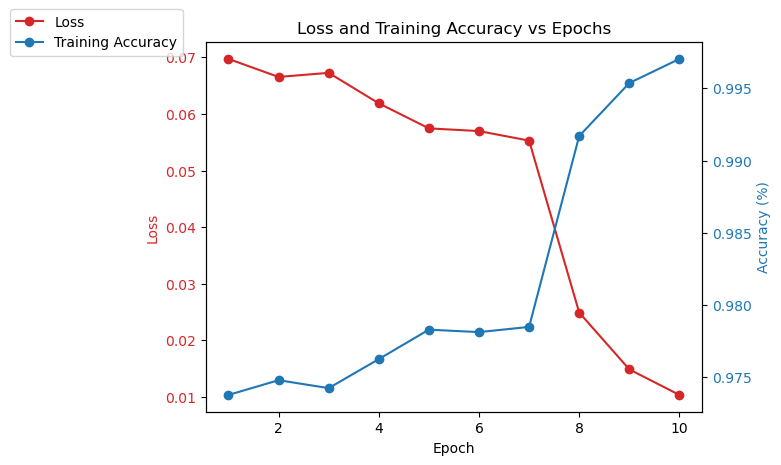

In [128]:
epochs = list(range(1, 11))

fig, ax1 = plt.subplots()
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color='tab:red')
ax1.plot(epochs, epoch_losses, marker='o', color='tab:red', label='Loss')
ax1.tick_params(axis='y', labelcolor='tab:red')

ax2 = ax1.twinx()
ax2.set_ylabel('Accuracy (%)', color='tab:blue')
ax2.plot(epochs, epoch_accuracies, marker='o', color='tab:blue', label='Training Accuracy')
ax2.tick_params(axis='y', labelcolor='tab:blue')

fig.legend(loc='center right', bbox_to_anchor=(0.1, 0.9))
plt.title('Loss and Training Accuracy vs Epochs')
plt.grid(False)
plt.show()

#### **ROC and Precision Recall Curves**

In [117]:
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score

def plot_roc_prc(model, test_loader, device):
    model.eval()
    all_labels = []
    all_preds = []

    # loop through the test dataset
    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)

            # get model predictions
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)

            # collect labels and predictions
            all_labels.extend(labels.cpu().numpy())
            all_preds.extend(predicted.cpu().numpy())

    # convert to numpy arrays for plotting
    all_labels = np.array(all_labels)
    all_preds = np.array(all_preds)

    # compute ROC curve and AUC
    fpr, tpr, _ = roc_curve(all_labels, all_preds)
    roc_auc = auc(fpr, tpr)

    # compute precision-recall curve
    precision, recall, _ = precision_recall_curve(all_labels, all_preds)
    average_precision = average_precision_score(all_labels, all_preds)

    # Plot ROC curve
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc="lower right")

    # Plot Precision-Recall curve
    plt.subplot(1, 2, 2)
    plt.plot(recall, precision, color='blue', lw=2, label=f'Precision-Recall curve (AP = {average_precision:.2f})')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc="lower left")

    plt.tight_layout()
    plt.show()

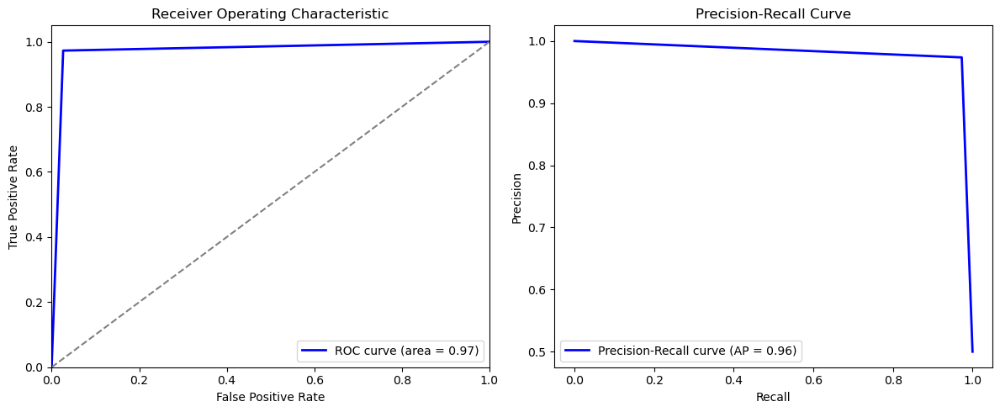

In [118]:
plot_roc_prc(model, test_loader, device)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Test Accuracy: 97.33%


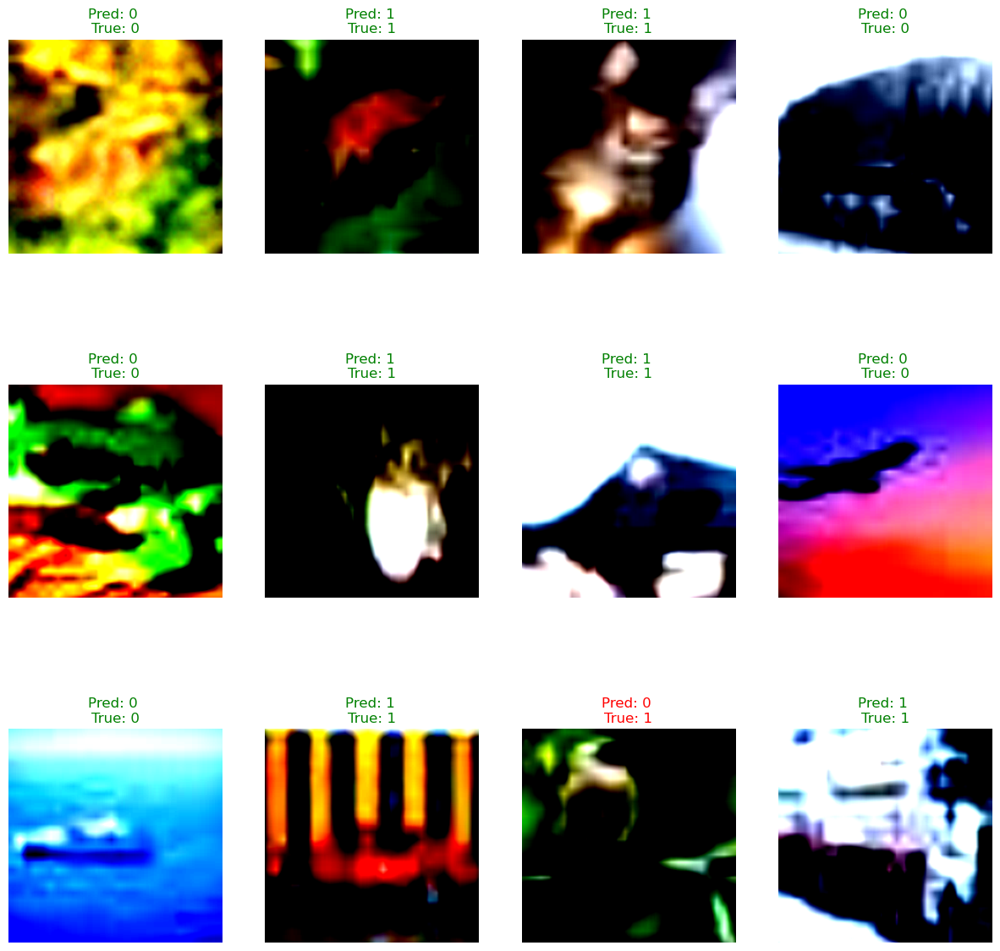

In [121]:
def imshow(img):
    img = img / 2 + 0.5  # unnormalize the image
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))  # Convert from CHW to HWC 
    plt.show()

# Function to display images with predictions
def plot_predictions(images, labels, predictions, num_rows, num_cols):
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))

    axes = axes.flatten()

    for i in range(len(images)):
        ax = axes[i]
        img = images[i].cpu().numpy().transpose(1, 2, 0) 
        ax.imshow(img)

        # Check if prediction is correct and choose color
        correct = predictions[i] == labels[i]
        color = 'green' if correct else 'red'

        ax.set_title(f"Pred: {predictions[i]} \nTrue: {labels[i]}", color=color)
        ax.axis('off')

    # Hide extra subplots
    for i in range(len(images), len(axes)):
        axes[i].axis('off')

    plt.show()

def evaluate_and_plot(model, test_loader, device, num_rows=2, num_cols=5):
    model.eval()
    correct = 0
    total = 0
    predictions = []
    labels_list = []
    images_list = []

    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)

            # forward pass
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)

            # store images, labels, and predictions for plotting
            images_list.extend(images.cpu())
            labels_list.extend(labels.cpu())
            predictions.extend(predicted.cpu())

            # update total correct and total count for accuracy calculation
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

    # calculate accuracy
    test_accuracy = correct / total
    print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

    total_images = num_rows * num_cols
    indices = random.sample(range(len(images_list)), total_images)
    plot_predictions([images_list[i] for i in indices],
                     [labels_list[i] for i in indices],
                     [predictions[i] for i in indices],
                     num_rows, num_cols)

evaluate_and_plot(model, test_loader, device, num_rows=3, num_cols=4)

## **Conclusion**

In this project, we successfully used the ResNet18 model to classify real vs fake images, using both the CIFAKE dataset and augmented fake images generated by a DCGAN. We fine-tuned it on the combined dataset by employing transfer learning on the pre-trained ResNet18 model, improving its ability to classify real and AI-generated images. This approach effectively enhanced the dataset's diversity, boosting the model’s generalization and robustness in real-world image classification tasks.

**Accuracy of fine-tuned RESNET-18 model: 97.33%**